In [25]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

In [26]:
merlin_output_folder = r'J:\MERFISH_Analysis\20210717-P_brain_MO4_MERFISH_renamed_data_full'

In [3]:
cell_meta_data_file = os.path.join(merlin_output_folder, 'ExportCellMetadata', 'feature_metadata.csv')
cell_meta_data = pd.read_csv(cell_meta_data_file)


In [4]:
cell_meta_data

,Unnamed: 0,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y
0,104909830155952950592209131332226699944,0,218.001863,-1720.404600,-6892.629997,-1725.000000,-1715.809200,-6896.258797,-6889.001197
1,105185252916644674911081849464378135868,0,571.015115,-1518.989995,-6992.098000,-1523.914795,-1514.065195,-6997.238800,-6986.957199
2,107305913892988042418366491039158657426,0,505.625328,-1536.539995,-7001.170000,-1541.950795,-1531.129195,-7005.554800,-6996.785200
3,109474314031724373061910304053387880779,0,136.202751,-1657.499998,-6969.525999,-1661.398798,-1653.601198,-6973.586799,-6965.465199
4,111067510466969092463918909419647122175,0,1207.618889,-1690.655999,-6872.811996,-1698.766799,-1682.545199,-6878.978797,-6866.645196
...,...,...,...,...,...,...,...,...,...
15263,93755703434725582730537181011860339994,100,4194.315714,1556.036002,-5798.245999,1544.577202,1567.494802,-5812.998800,-5783.493199
15264,94090733409490871673672446664542685342,100,1339.343014,1697.888606,-5815.310000,1690.701205,1705.076006,-5823.798800,-5806.821199
15265,94489673132572037254565148131177263696,100,856.796252,1489.891400,-5634.679995,1484.000000,1495.782800,-5640.738795,-5628.621195
15266,95420983838812228005145930757237258190,100,1459.440346,1584.224003,-5718.217997,1575.789202,1592.658803,-5728.974797,-5707.461197


In [5]:
# Load MERFISH data
counts_file_mer = os.path.join(merlin_output_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
#blanks = [f'Blank-{i}' for i in range(1, 11)]
for _c in df.columns:
    if 'Blank-' in _c:
        df = df.drop(columns=_c)
adata = anndata.AnnData(df)
adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')

In [30]:
# Load MERFISH data
counts_file_mer = os.path.join(merlin_output_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
#blanks = [f'Blank-{i}' for i in range(1, 11)]
for _c in df.columns:
    if 'Blank-' in _c:
        df = df.drop(columns=_c)

In [31]:
df

,1700022I11Rik,1810046K07Rik,5031425F14Rik,5730522E02Rik,Acta2,Adam2,Adamts2,Adamts4,Adra1b,Alk,...,Unc13c,Unc5b,Unc5d,Ust,Vipr2,Vtn,Vwc2,Wipf3,Wnt7b,Zfp804b
index,,,,,,,,,,,,,,,,,,,,,
104909830155952950592209131332226699944,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
105185252916644674911081849464378135868,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,19.0,0.0,0.0,0.0,0.0,0.0,1.0
107305913892988042418366491039158657426,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,...,0.0,3.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0,0.0
109474314031724373061910304053387880779,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
111067510466969092463918909419647122175,0.0,0.0,0.0,0.0,2.0,0.0,0.0,11.0,0.0,2.0,...,0.0,2.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93755703434725582730537181011860339994,0.0,2.0,0.0,1.0,3.0,1.0,3.0,3.0,27.0,5.0,...,3.0,0.0,54.0,8.0,2.0,1.0,2.0,188.0,3.0,2.0
94090733409490871673672446664542685342,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,0.0,1.0
94489673132572037254565148131177263696,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [35]:
# load gene names
sel_gene_df = pd.read_excel(r'\\10.245.74.212\Chromatin_NAS_2\Chromatin_Libraries\CTP-11_brain\smFISH_cell_class\MOP_marker_gene_readout.xlsx',
                          )

In [43]:
gene_2_count = {}
for _gene in sel_gene_df['Target gene']:
    if _gene in df.columns:
        _counts = df[_gene]
        gene_2_count[_gene] = np.array(_counts)
    else:
        gene_2_count[_gene] = []
        
    

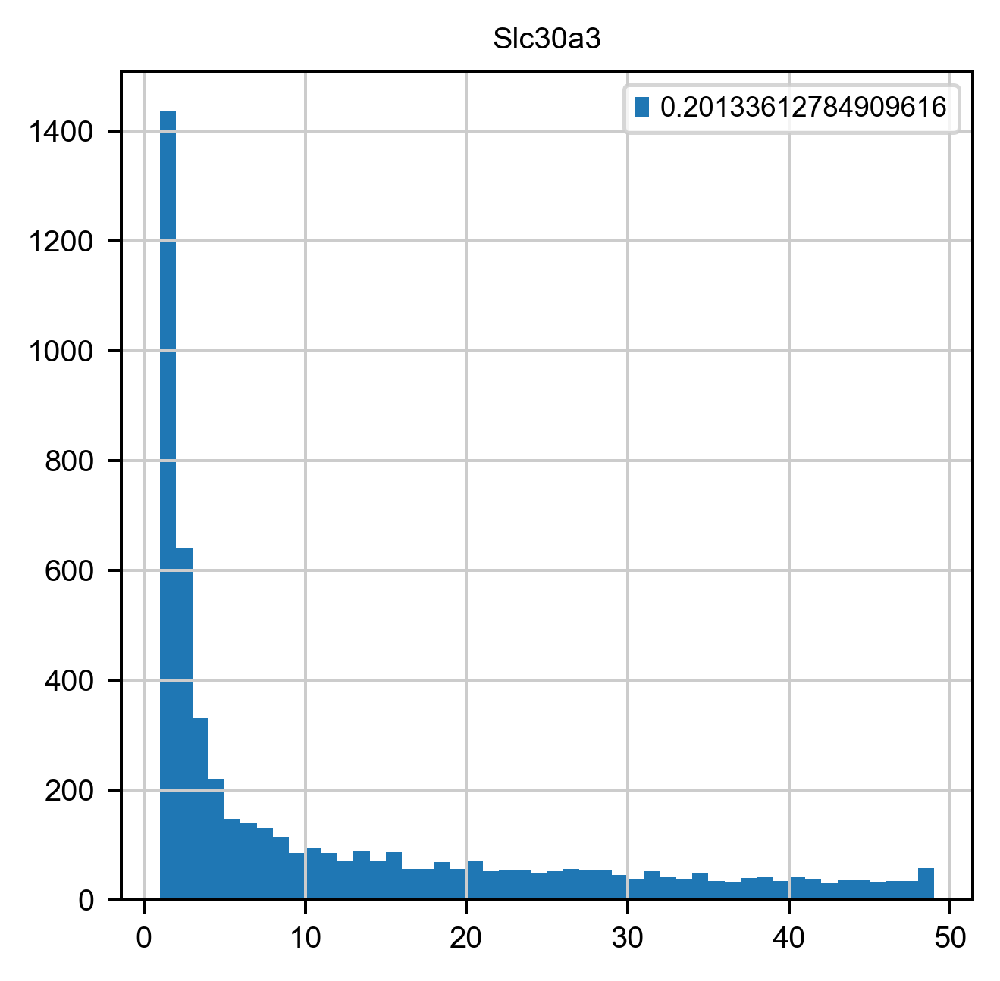

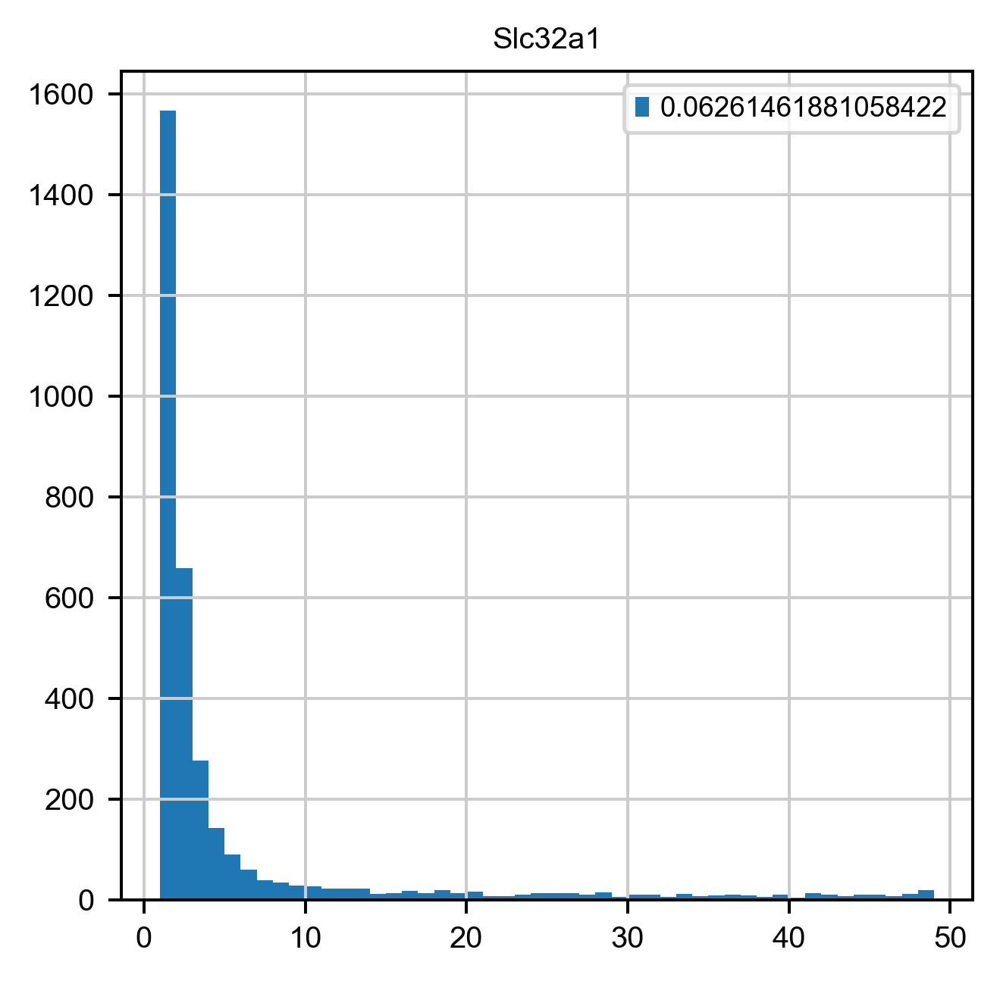

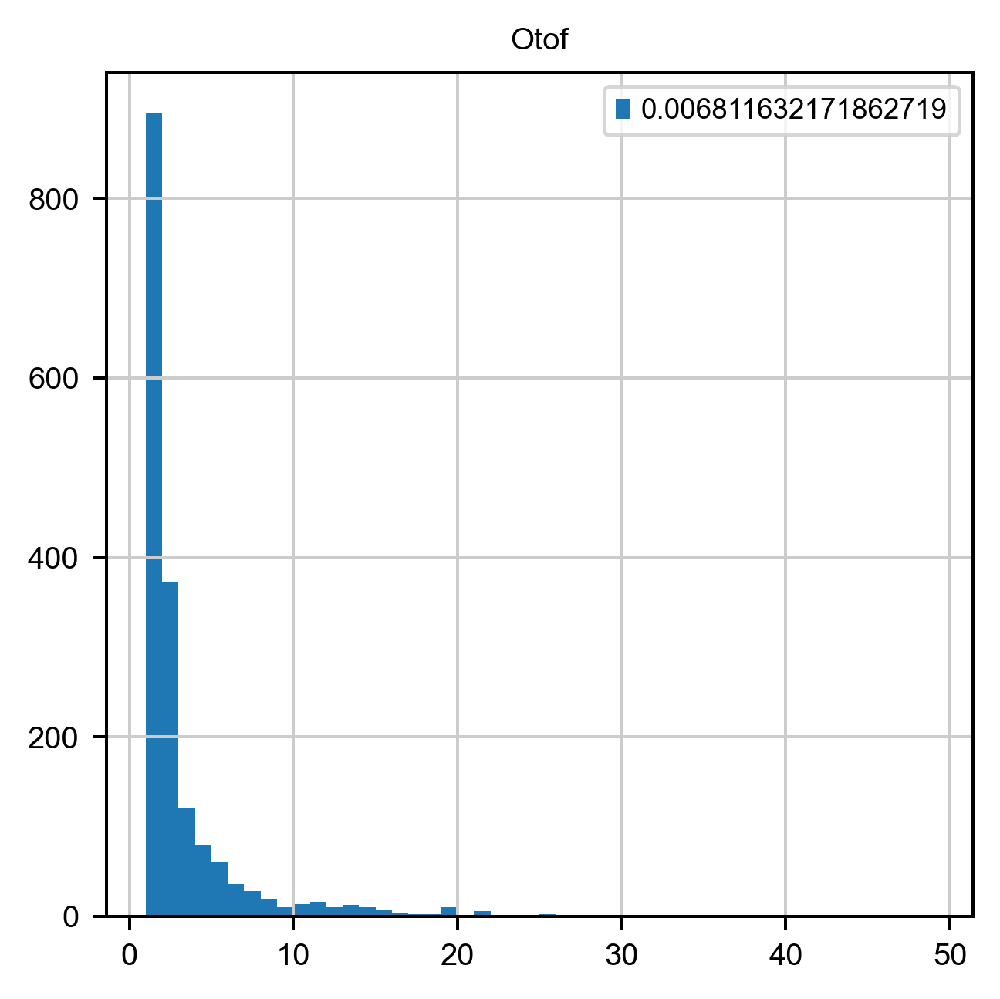

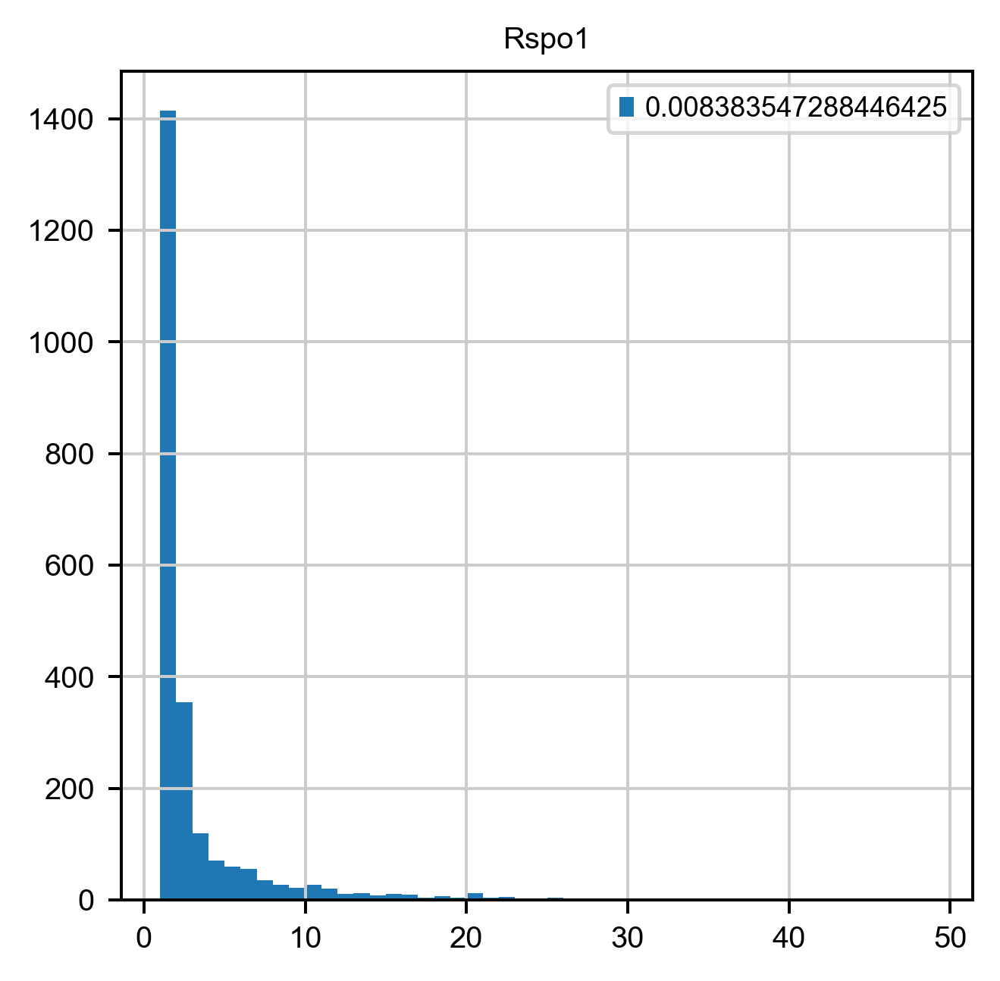

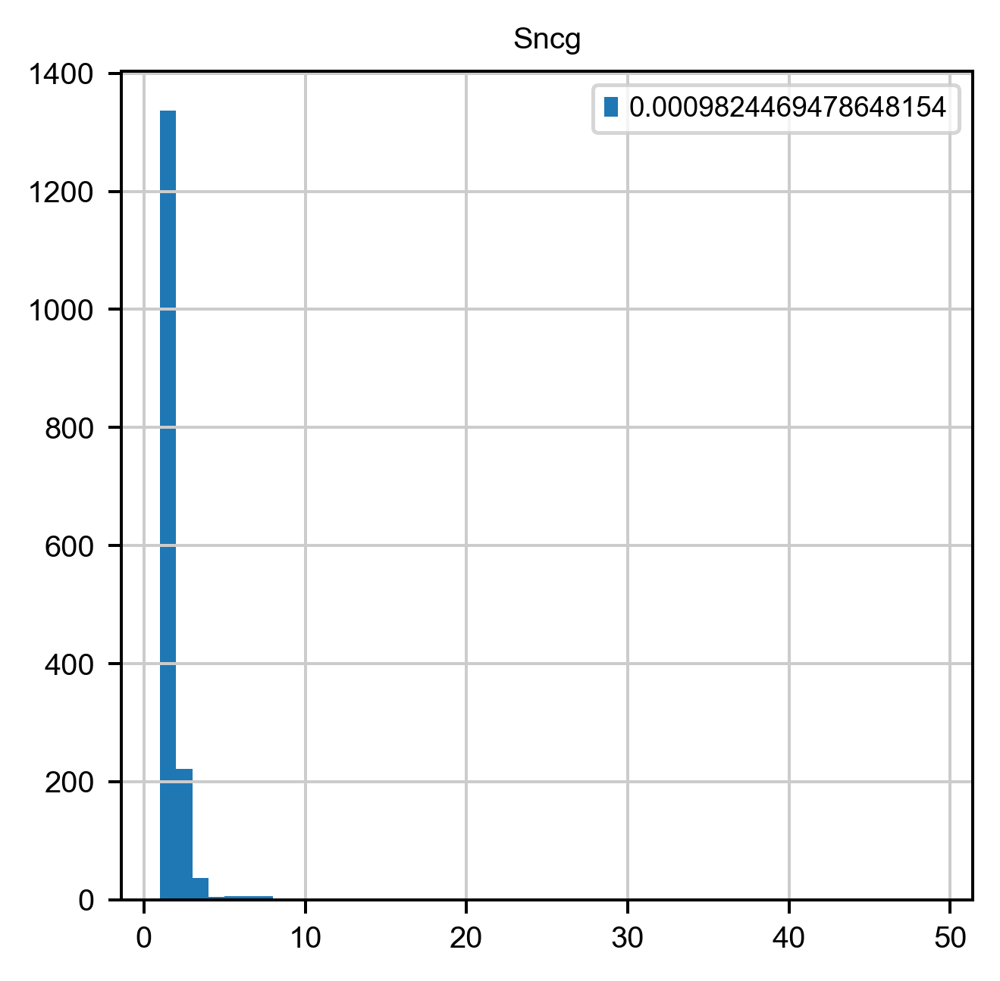

...

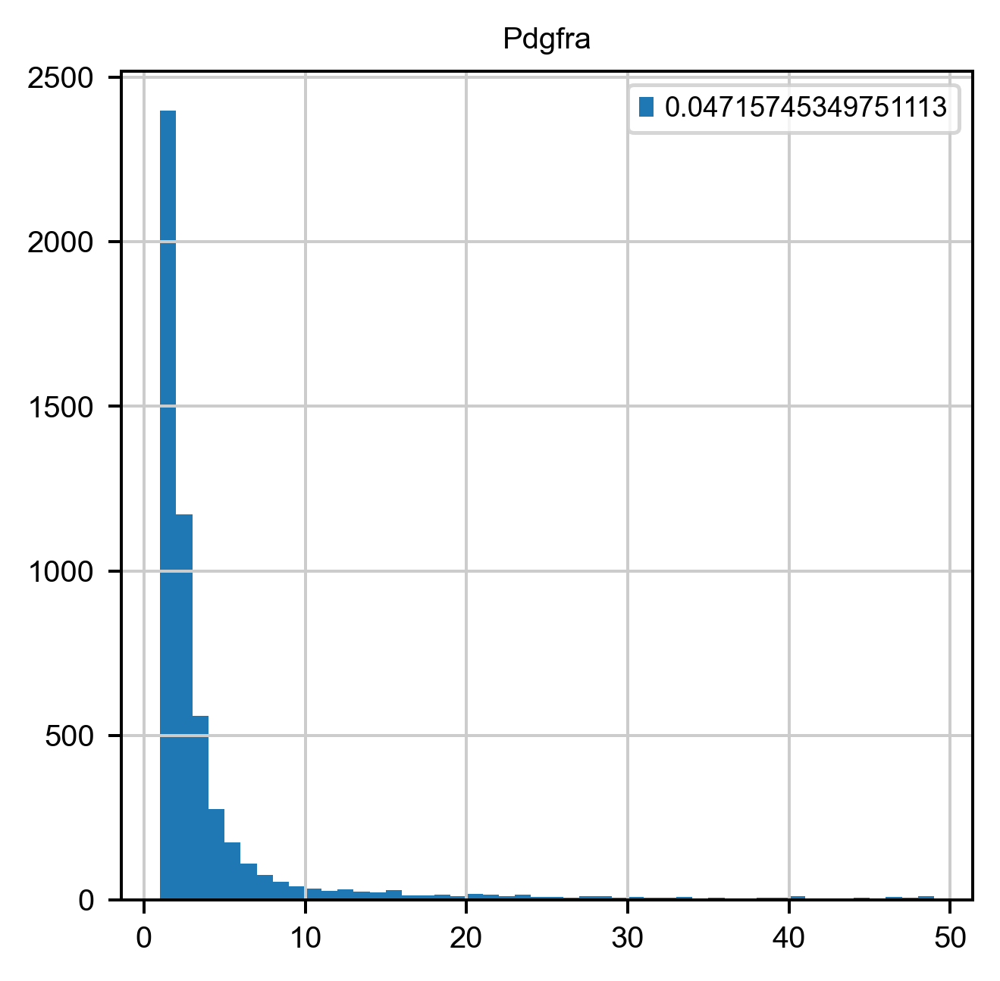

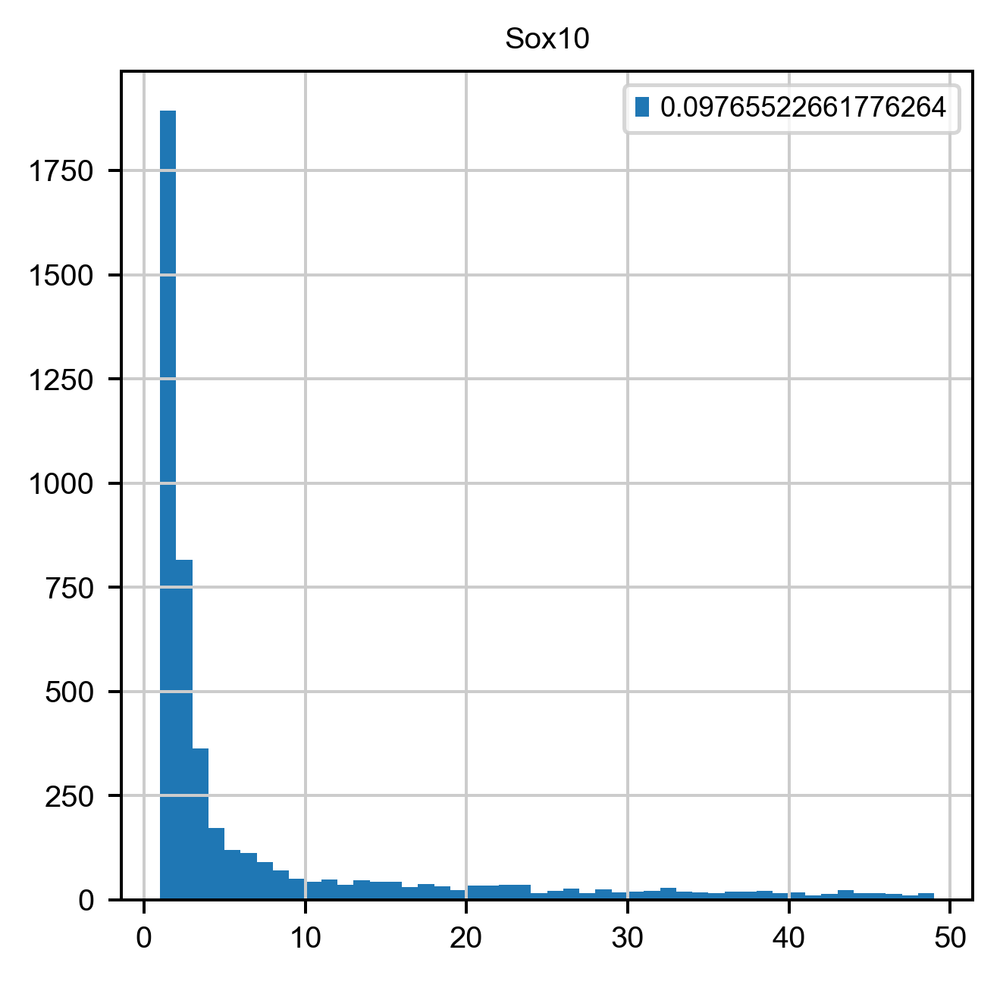

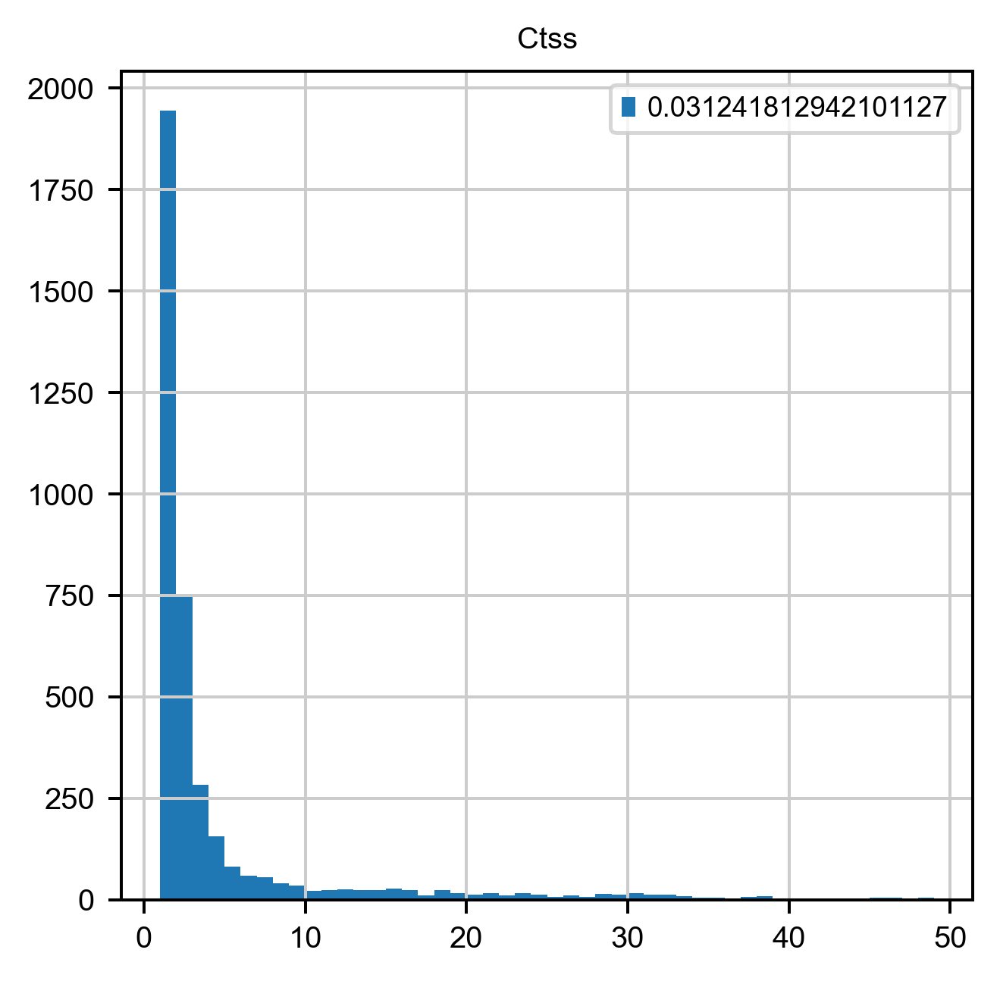

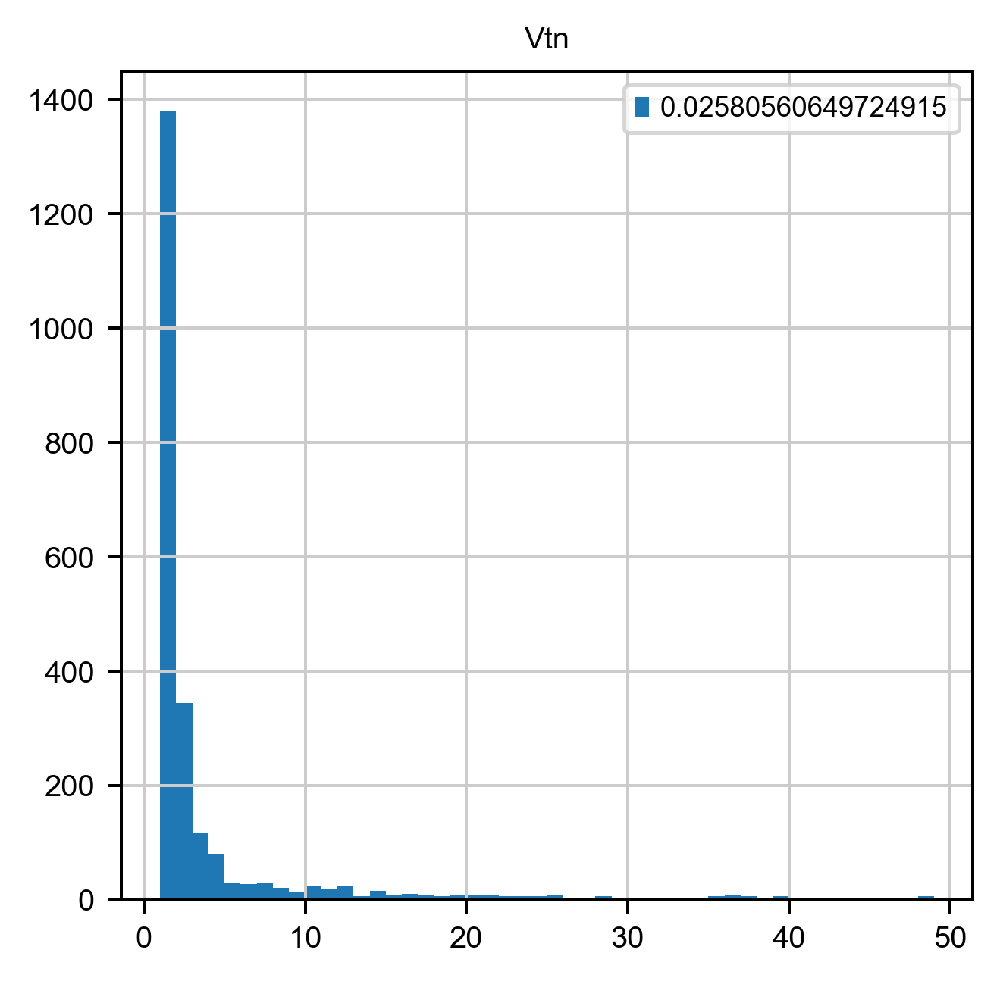

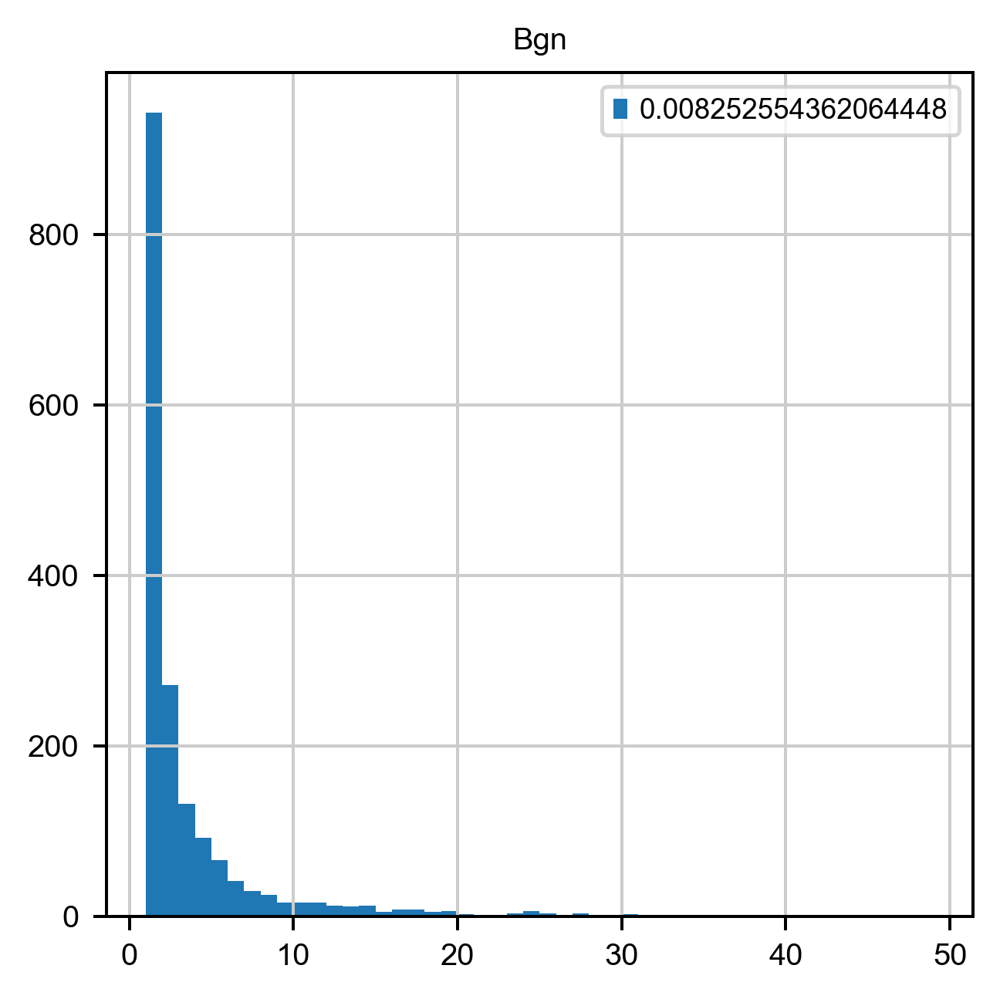

In [57]:
for _gene, _counts in gene_2_count.items():
    if len(_counts) > 0:
        plt.figure()
        plt.hist(_counts, bins=np.arange(1,50), label=f"{np.mean(_counts>10)}")
        plt.legend()
        plt.title(_gene)
        plt.show()

In [ ]:
gene_to_percent = pd.DataFrame()
gene_to_percent['gene'] = list(gene_2_count.keys())

In [54]:
percent_counts = []
count_th = 20
for _gene, _counts in gene_2_count.items():
    if len(_counts) > 0:
        percent_counts.append(np.mean(_counts>count_th))
    else:
        percent_counts.append(np.nan)

In [55]:

gene_to_percent[f'percentage > {count_th}'] = percent_counts

In [56]:
gene_to_percent

,gene,percentage > 10,percentage > 20
0,Slc30a3,0.201336,0.154637
1,Slc17a7,NaN,NaN
2,Slc32a1,0.062615,0.051284
3,Gad1,NaN,NaN
4,Otof,0.006812,0.001703
5,Rspo1,0.008384,0.001965
6,Pvalb,NaN,NaN
7,Sst,NaN,NaN
8,Vip,NaN,NaN
9,Sncg,0.000982,0.000458


In [6]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)

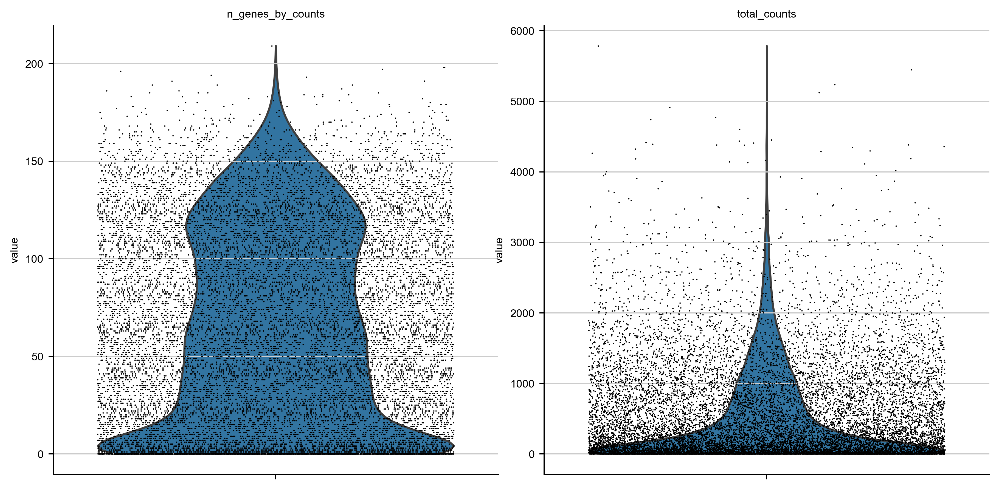

In [7]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [8]:
adata.obs

,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y,n_genes_by_counts,total_counts
Unnamed: 0,,,,,,,,,,
104909830155952950592209131332226699944,0,218.001863,-1720.404600,-6892.629997,-1725.000000,-1715.809200,-6896.258797,-6889.001197,0,0.0
105185252916644674911081849464378135868,0,571.015115,-1518.989995,-6992.098000,-1523.914795,-1514.065195,-6997.238800,-6986.957199,45,197.0
107305913892988042418366491039158657426,0,505.625328,-1536.539995,-7001.170000,-1541.950795,-1531.129195,-7005.554800,-6996.785200,34,78.0
109474314031724373061910304053387880779,0,136.202751,-1657.499998,-6969.525999,-1661.398798,-1653.601198,-6973.586799,-6965.465199,18,39.0
111067510466969092463918909419647122175,0,1207.618889,-1690.655999,-6872.811996,-1698.766799,-1682.545199,-6878.978797,-6866.645196,92,383.0
...,...,...,...,...,...,...,...,...,...,...
93755703434725582730537181011860339994,100,4194.315714,1556.036002,-5798.245999,1544.577202,1567.494802,-5812.998800,-5783.493199,171,4141.0
94090733409490871673672446664542685342,100,1339.343014,1697.888606,-5815.310000,1690.701205,1705.076006,-5823.798800,-5806.821199,31,79.0
94489673132572037254565148131177263696,100,856.796252,1489.891400,-5634.679995,1484.000000,1495.782800,-5640.738795,-5628.621195,12,25.0


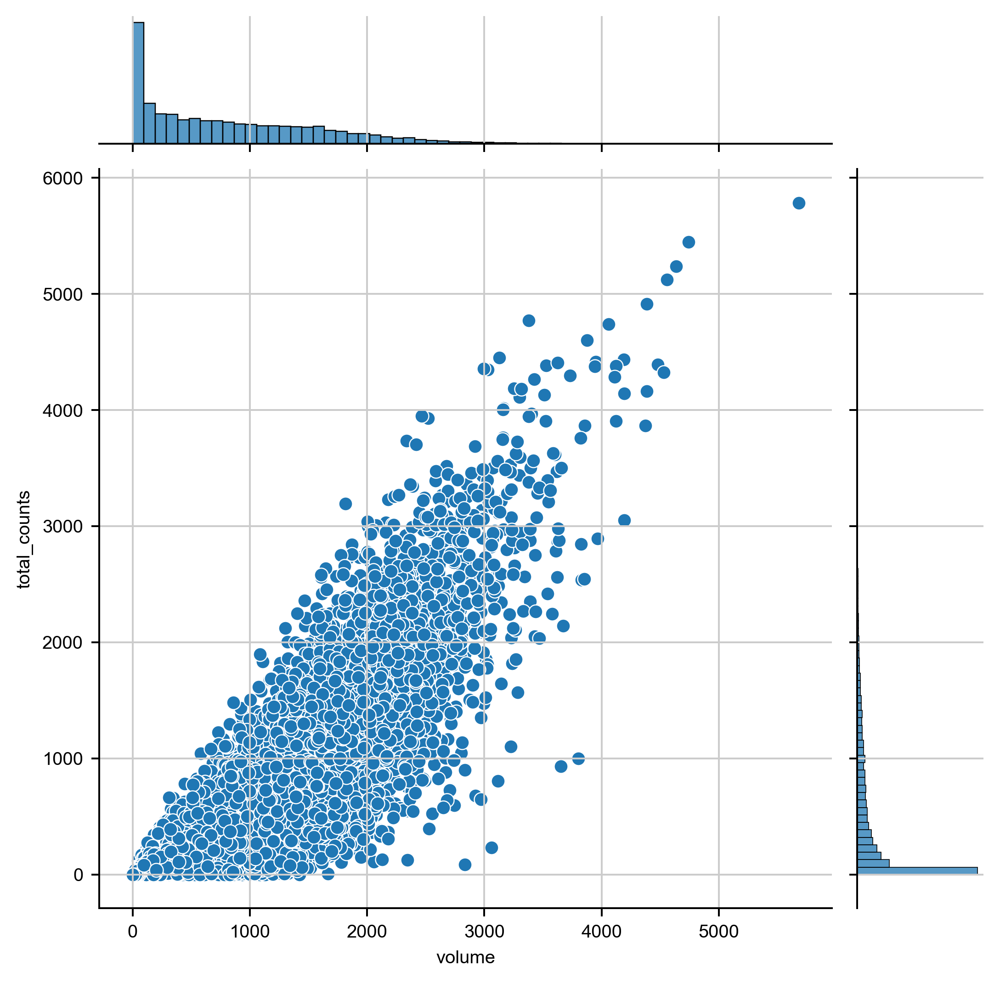

In [9]:
sns.jointplot(data=adata.obs, x='volume', y='total_counts')

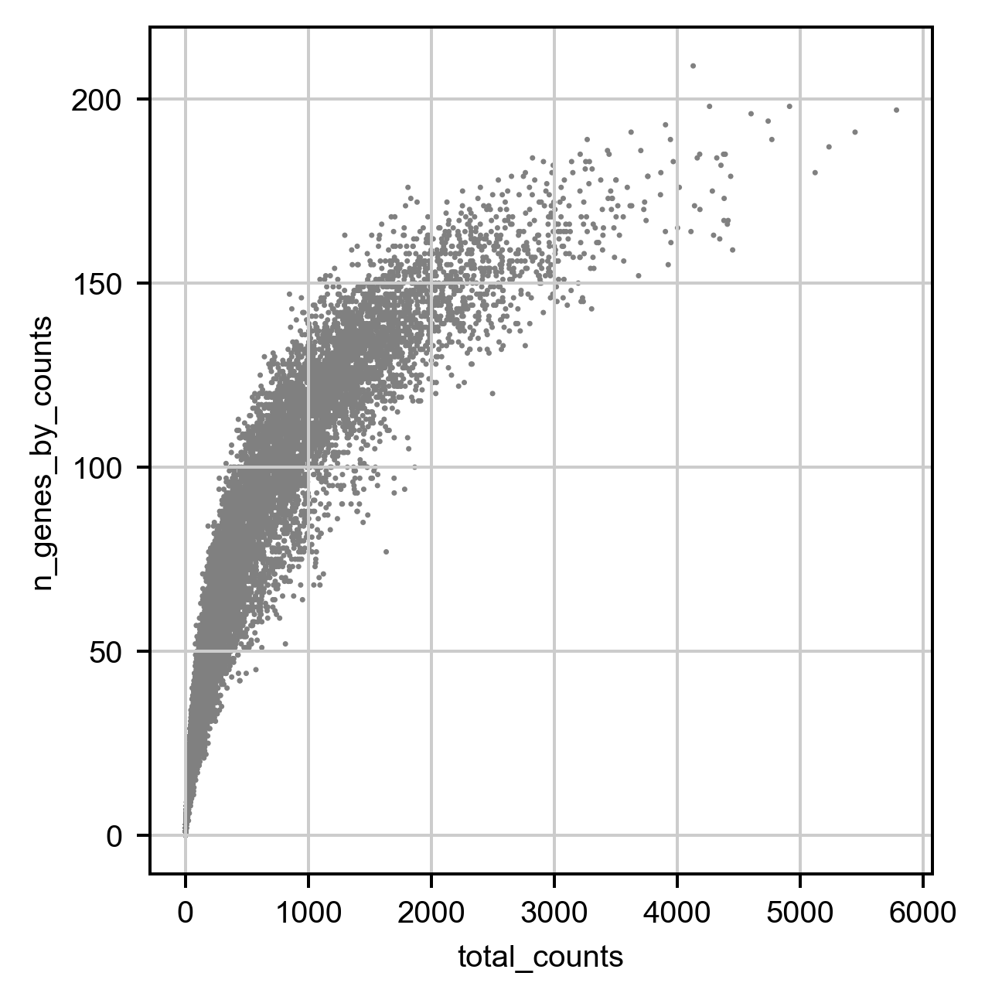

In [10]:
# Plot the distributions of gene counts
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [11]:
adata = adata[adata.obs['total_counts'] > 10]
adata = adata[adata.obs['n_genes_by_counts'] > 10]

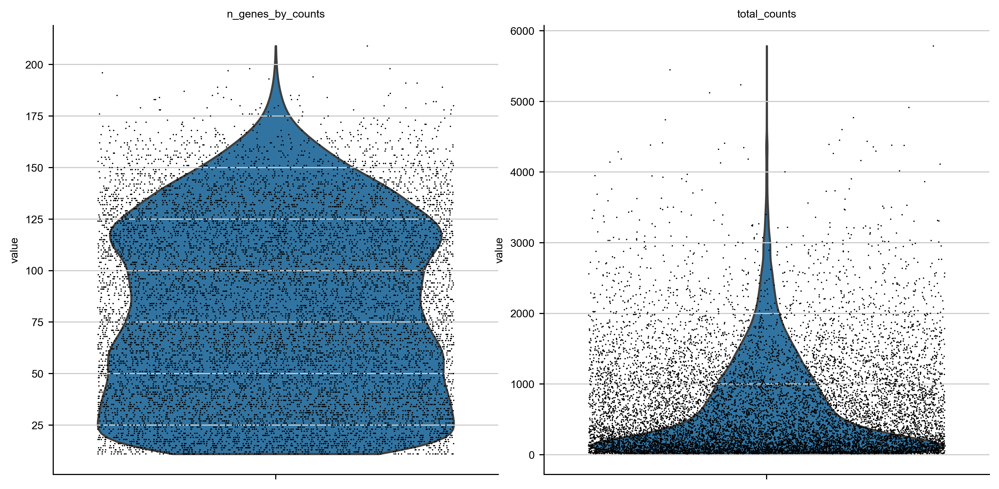

In [12]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [13]:
max(adata.obs['total_counts'])

5784.0

E:\Users\puzheng\AppData\anaconda3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


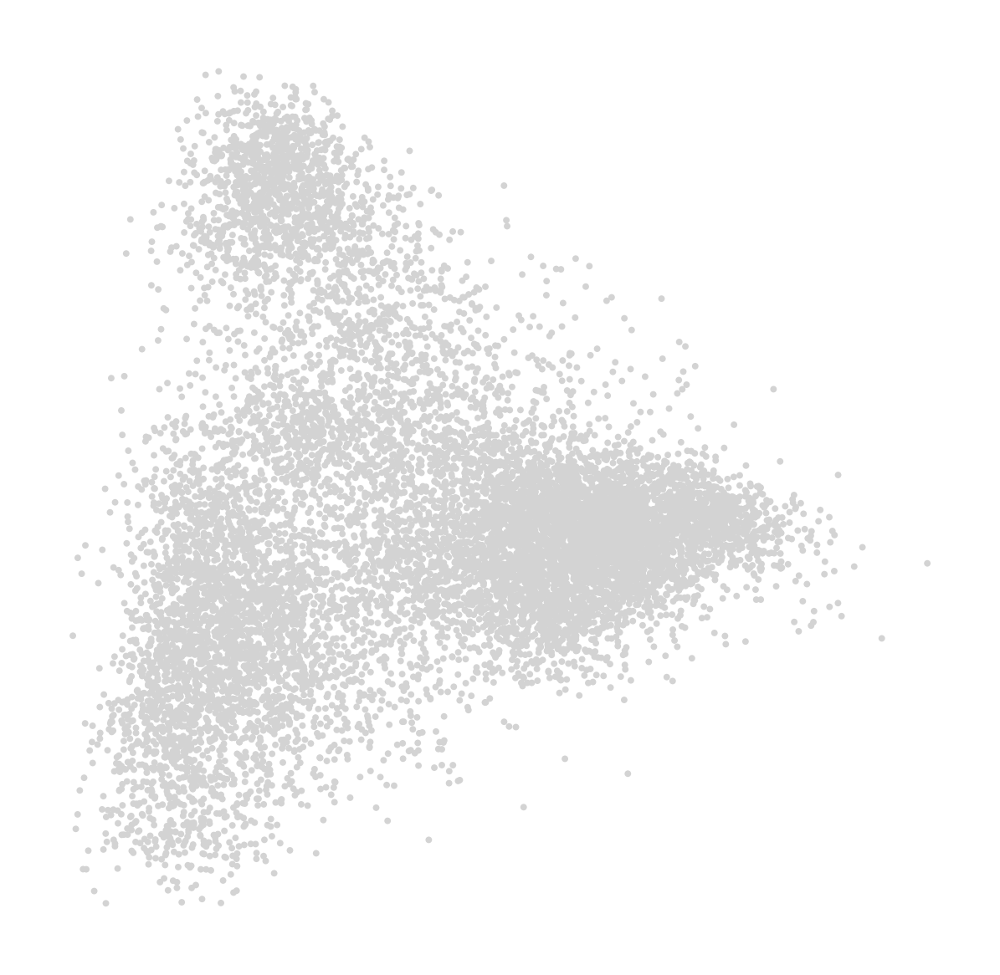

In [14]:
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(adata)
# Regress out total counts
sc.pp.regress_out(adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(adata, max_value=10)
# Principal component analysis
sc.tl.pca(adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(adata)

In [15]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)

Wall time: 34.9 s


In [16]:
%%time
# Clustering
sc.tl.leiden(adata, resolution=2)

Wall time: 2.26 s


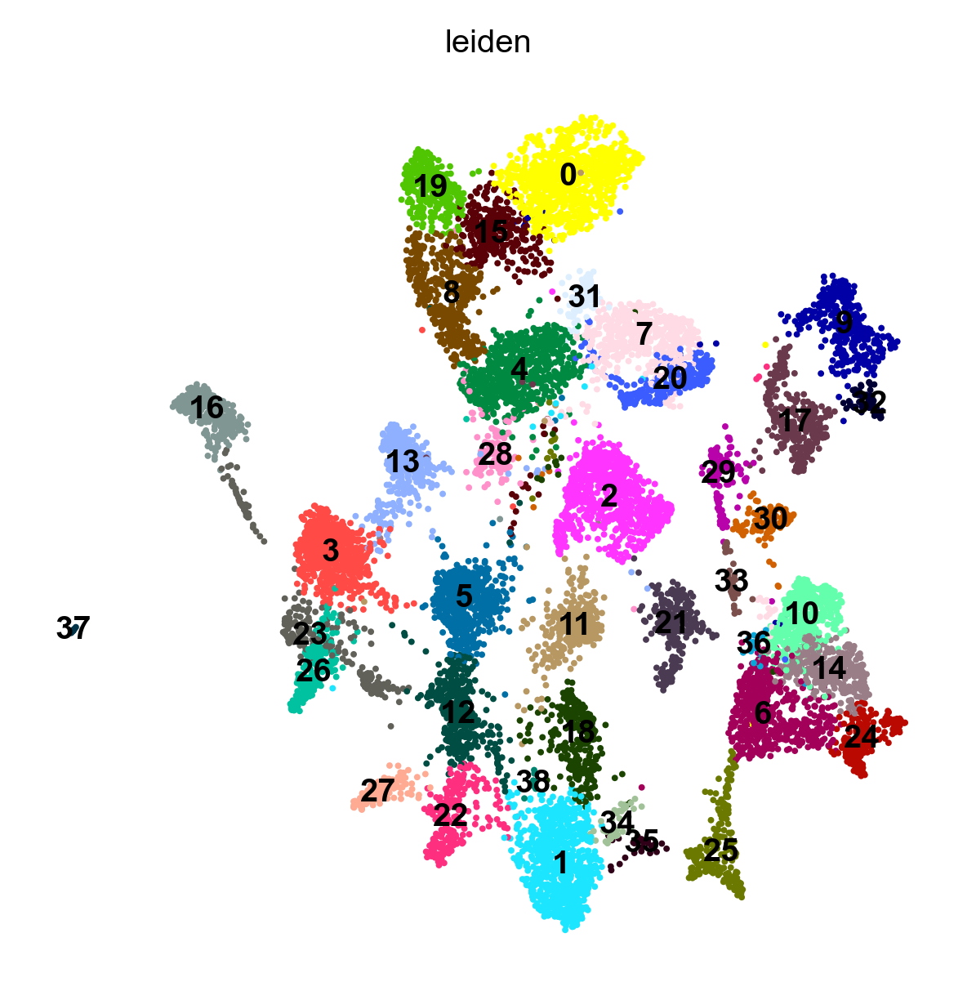

Wall time: 2min 40s


In [17]:
%%time
# Embed with UMAP
sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

In [18]:
adata.obs

,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y,n_genes_by_counts,total_counts,leiden
Unnamed: 0,,,,,,,,,,,
105185252916644674911081849464378135868,0,571.015115,-1518.989995,-6992.098000,-1523.914795,-1514.065195,-6997.238800,-6986.957199,45,197.0,18
107305913892988042418366491039158657426,0,505.625328,-1536.539995,-7001.170000,-1541.950795,-1531.129195,-7005.554800,-6996.785200,34,78.0,34
109474314031724373061910304053387880779,0,136.202751,-1657.499998,-6969.525999,-1661.398798,-1653.601198,-6973.586799,-6965.465199,18,39.0,5
111067510466969092463918909419647122175,0,1207.618889,-1690.655999,-6872.811996,-1698.766799,-1682.545199,-6878.978797,-6866.645196,92,383.0,11
116068292915515410951921399450671030529,0,1640.058096,-1525.901995,-6999.712000,-1534.066795,-1517.737195,-7008.362800,-6991.061200,68,405.0,6
...,...,...,...,...,...,...,...,...,...,...,...
93755703434725582730537181011860339994,100,4194.315714,1556.036002,-5798.245999,1544.577202,1567.494802,-5812.998800,-5783.493199,171,4141.0,0
94090733409490871673672446664542685342,100,1339.343014,1697.888606,-5815.310000,1690.701205,1705.076006,-5823.798800,-5806.821199,31,79.0,0
94489673132572037254565148131177263696,100,856.796252,1489.891400,-5634.679995,1484.000000,1495.782800,-5640.738795,-5628.621195,12,25.0,3


(-1889.2891300995834,
 1871.1957358815707,
 -7986.387860125489,
 -4838.9961341260005)

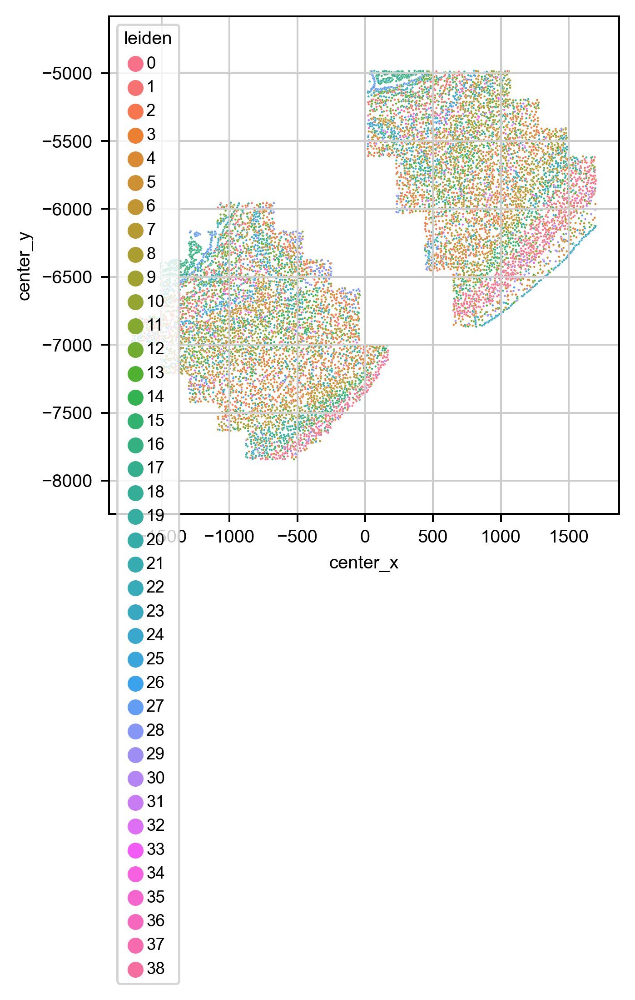

In [20]:
import matplotlib.pyplot as plt
sns.scatterplot(data=adata.obs, x='center_x', y='center_y', hue='leiden', s=1)
plt.axis('equal')

(-1889.2891300995834,
 1871.1957358815707,
 -7986.387860125489,
 -4838.9961341260005)

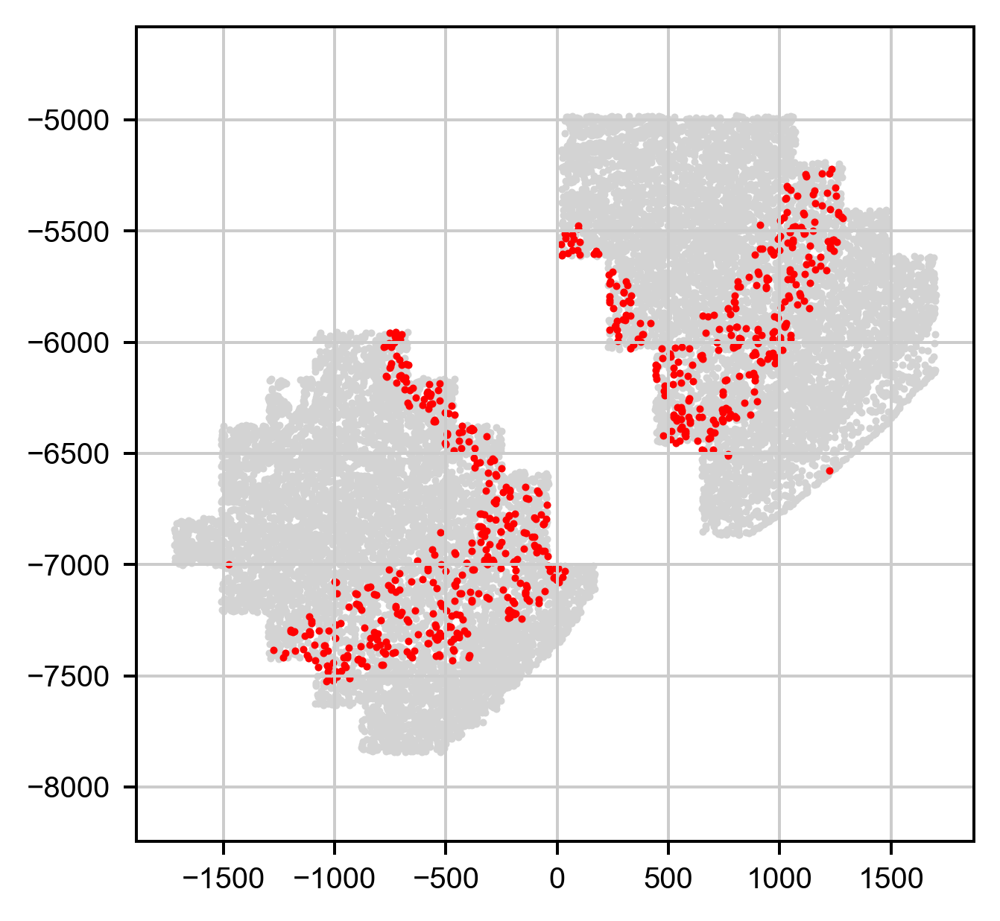

In [21]:
import matplotlib.pyplot as plt

plt.scatter(adata.obs['center_x'], adata.obs['center_y'], c='lightgrey', s=1)

df = adata.obs[adata.obs['leiden'] == '2']
plt.scatter(df['center_x'], df['center_y'], c='red', s=1)
plt.axis('equal')

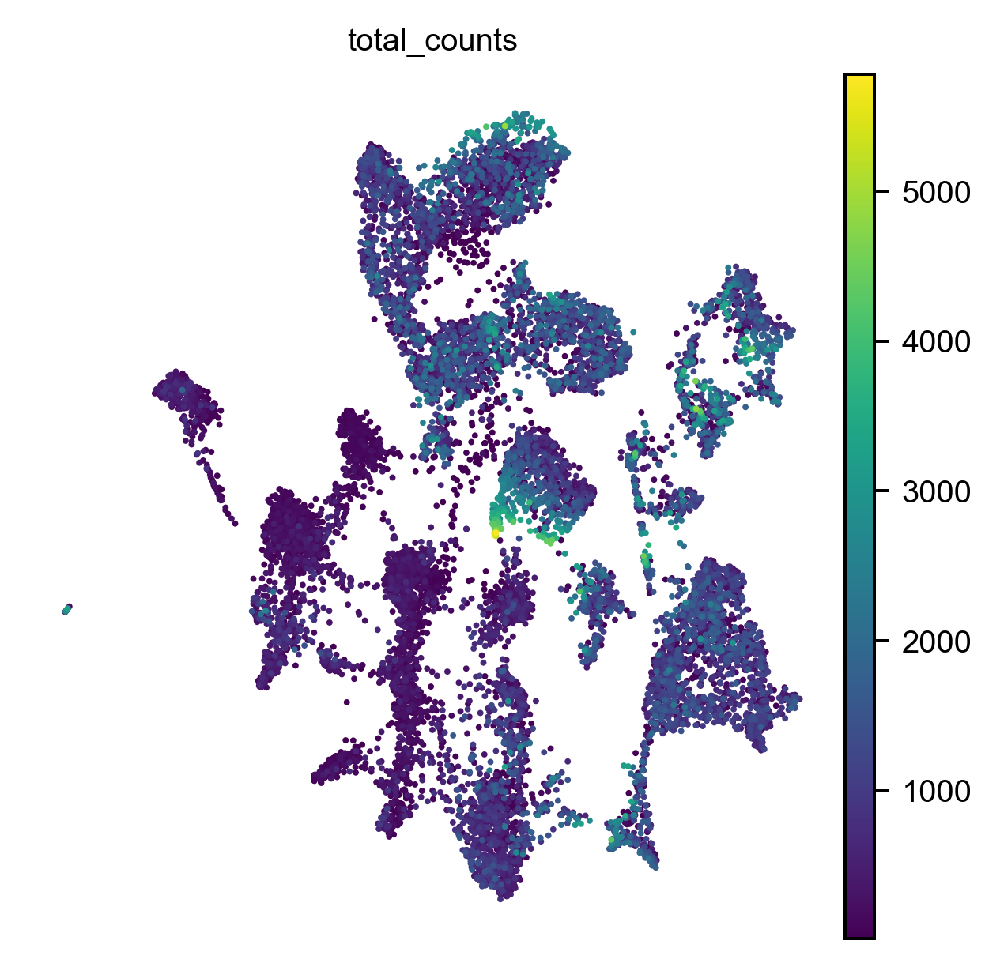

In [22]:
sc.pl.umap(adata, color='total_counts')

In [23]:
marker_genes = ['Slc17a7', 'Slc32a1', 'Slc30a3', 'Cux2', 'Rorb', 'Sulf2', 'Ptpru', 'Car3', 'Fam84b', 'Syt6', 
               'Nxph4', 'Tshz2', 'Pvalb', 'Sst', 'Vip', 'Sncg', 'Lamp5', 'Sox10', 'Pdgfra', 'Aqp4', 'Igf2',
               'Ctss', 'Cldn5', 'Flt1', 'Bgn', 'Vtn']
marker_genes = [g for g in marker_genes if (g in adata.var.index)]

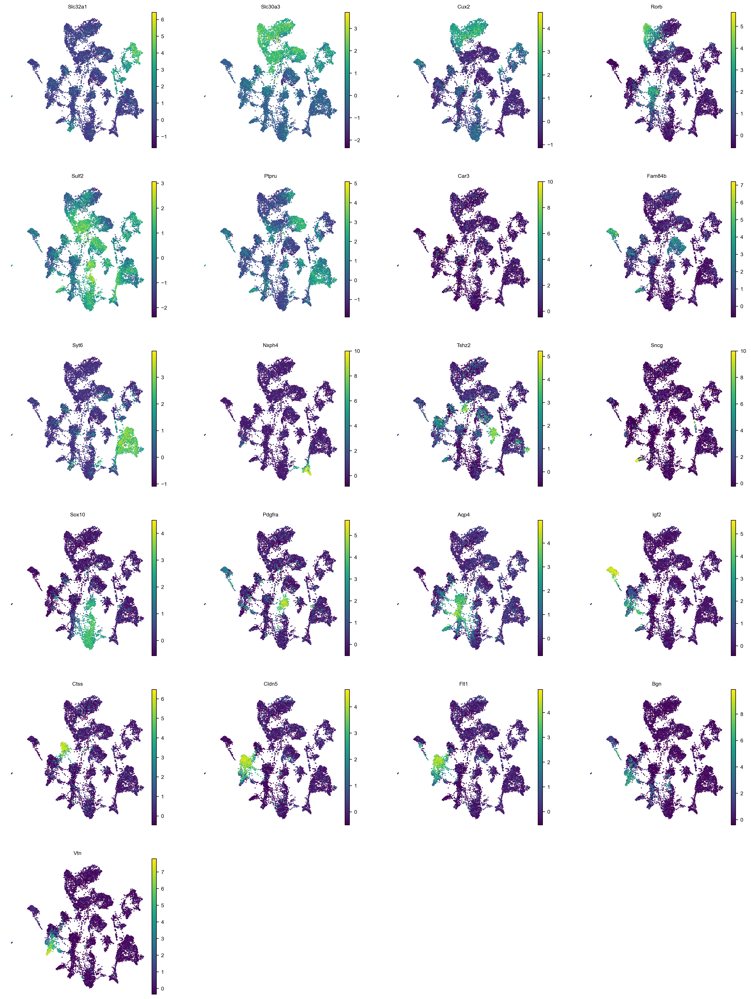

In [24]:
sc.pl.umap(adata, color=marker_genes)

In [104]:
from PIL import Image

In [114]:
import skimage.io as skio
imstack1    = skio.imread(r'J:\MERFISH_Analysis\20210529-P_Forebrain_MERFISH4_CTP09_exp2_test\FiducialCorrelationWarp\images\aligned_images0.tif', plugin="tifffile")

In [123]:
ims = []
for _i in range(int(len(imstack1)/8)):
    ims.append(imstack1[_i*8:(_i+1)*8])

In [124]:
%run "..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
%matplotlib notebook

from ImageAnalysis3 import *
print(os.getpid())

17416


<IPython.core.display.Javascript object>


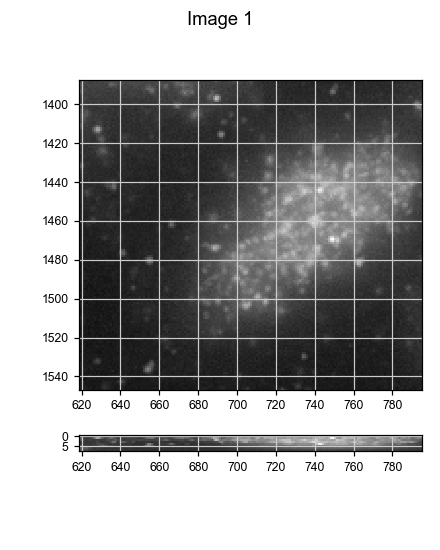

In [125]:
visual_tools.imshow_mark_3d_v2(ims)